Acquisition and Analysis of Neural Data 

Exercise 06

Bramantyo Ibrahim Supriyatno

In [1]:
import numpy as np 
import math
import seaborn as sns 
import matplotlib.pyplot as plt 

sns.set(style="white", context="paper", palette="pastel")
plt.style.use('seaborn')

In [2]:
def get_firing_rate(x, a, mean=1.5, std=0.3):
    return a * np.exp(- ((x - mean)**2)/(2*(std**2)))

In [3]:
def generate_inhomogeneous_poisson(rates, del_t, t):    
    max_rate = np.max(rates)
    prob = rates * del_t
    spikes = np.random.uniform(size = rates.shape[0])
    trains = (spikes < prob).astype(int)  

    trains_time = t[trains==True]
    return trains, trains_time

In [4]:
track_length = 3 
speed = 0.1
max_t = track_length / speed
del_t = 1e-2
num_data = int(max_t/del_t)
num_trial = 1000

x_pos = np.linspace(0, track_length, num_data)

t = np.arange(0, max_t, del_t)

rates = get_firing_rate(x_pos, 20)

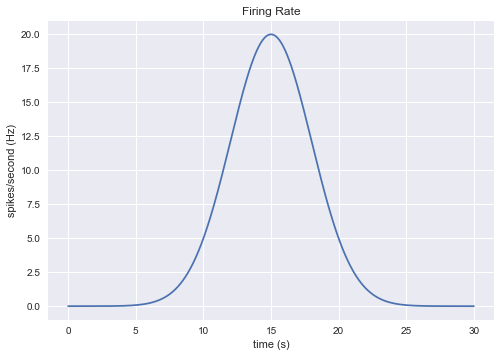

In [5]:
plt.plot(t, rates)
plt.title('Firing Rate')
plt.ylabel('spikes/second (Hz)')
plt.xlabel('time (s)')
plt.show()

In [6]:
spike_trains = np.zeros((num_trial, num_data))
spike_train_times = []

for i in range(num_trial):
    spike_train, times = generate_inhomogeneous_poisson(rates, del_t, t)
    spike_trains[i] = spike_train
    spike_train_times.append(times)

In [7]:
def raster_plot(ax, spike_train_times, t):
    ax.eventplot(spike_train_times)
    #ax.set_xlim(np.max(t))
    #ax.set_ylim(len(spike_train_times))
    ax.set_title('Raster Plot')
    ax.set_ylabel('trial number')
    ax.set_xlabel('time (s)')

In [8]:
def trial_average_rate_plot(ax, spike_trains, t):
    rates = np.sum(spike_trains, axis=0)/np.max(t)
    ax.plot(t, rates)
    ax.set_title('Trial Average Rate')
    ax.set_ylabel('rate (hz)')
    ax.set_xlabel('time (s)')

In [9]:
def poisson_pdf(rate, period, t):
    k_i = int(period * rate)
    return np.power(rate*t, k_i) * np.exp(-rate * t) 

def plot_multiple_poisson_pdf(ax, rates, t, max_t):
    pdfs = np.zeros((rates.shape[0], t.shape[0]))

    for i in range(rates.shape[0]):
        pdfs[0] = poisson_pdf(rates[i], max_t, t)
    
    ax.imshow(pdfs)



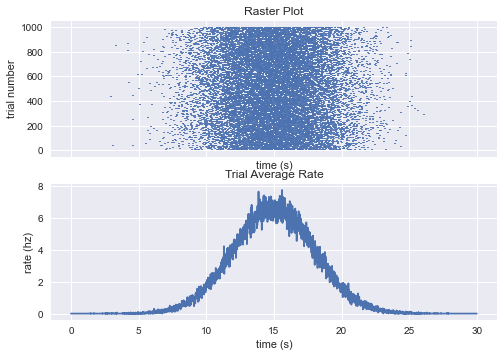

In [12]:
fig,ax = plt.subplots(2,1, sharex=True)
raster_plot(ax[0], spike_train_times, t)
trial_average_rate_plot(ax[1], spike_trains, t)
#plot_multiple_poisson_pdf(ax[2], rates, t, max_t)

2. Calculating entropy and mutual information

In [27]:
num_bins = int(track_length/0.1) 
resample_ratio = int(num_data / num_bins)
resample_kernel = np.ones(resample_ratio)

resampled_spikes = np.zeros((num_trial, num_bins))
for trial in range(num_trial):
    for nbin in range(num_bins):
        resampled_spikes[trial, nbin] = np.sum(spike_trains[trial,nbin*resample_ratio:(nbin+1)*resample_ratio])

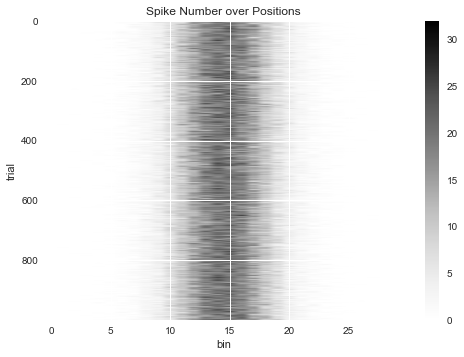

In [30]:
plt.imshow(resampled_spikes, aspect='auto')
plt.colorbar()
plt.title('Spike Number over Positions')
plt.xlabel('bin')
plt.ylabel('trial')
plt.show()

In [17]:
num_bins

30